In [16]:
from IPython.display import Audio
import torchaudio
import torch

In [11]:
x, _ = torchaudio.load("all_frames/1.wav")

In [12]:
x.shape

torch.Size([2, 225351])

### Generating Full Songs via Zach's windowing method
Original Backing Track

In [37]:
backg, _ = torchaudio.load("all_frames/upbeatrockbackCONVERT.wav")
Audio(backg.numpy(), rate=44100)

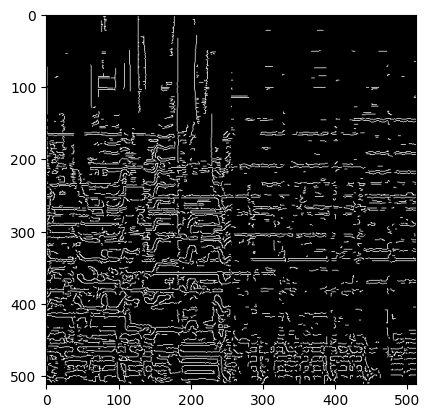

#### Choosing the "last half" of every audio frame
 i.e., each frame has been passed through riff-cnet once

In [49]:
initial, _ = torchaudio.load("all_frames/0.wav")


# 'Generate an up-tempo female vocal rock melody'


#Tune this
fudge_factor = 1000

initial = initial[:112676+fudge_factor]
full_audio = [initial]
for i in range(0,25):
    x, _ = torchaudio.load("all_frames/" + str(i) + ".wav")
    x = x[:, 112676+fudge_factor:]
    full_audio.append(x)

full_audio = torch.concatenate(full_audio, axis=-1 )
Audio(full_audio.numpy(), rate=44100)

#### Choosing the "first half" of every audio frame
 i.e., each frame has been passed through riff-cnet twice, except for the first frame. Maybe makes less sense

In [52]:
full_audio = []
for i in range(0,25):
    x, _ = torchaudio.load("all_frames/" + str(i) + ".wav")
    
    if i != 5:
        x = x[:, 112675:]
    full_audio.append(x)

full_audio = torch.concatenate(full_audio, axis=-1 )
Audio(full_audio.numpy(), rate=44100)

#### Other ideas - cross fading?